In [1]:
pip install tensorflow-object-detection-api

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 577 kB 5.2 MB/s 
     |████████████████████████████████| 120 kB 47.7 MB/s 
     |████████████████████████████████| 1.6 MB 39.1 MB/s 
     |████████████████████████████████| 82 kB 753 kB/s 
     |████████████████████████████████| 237 kB 41.4 MB/s 
     |████████████████████████████████| 54 kB 1.6 MB/s 
     |████████████████████████████████| 48 kB 4.5 MB/s 
     |████████████████████████████████| 4.0 MB 18.9 MB/s 
  Created wheel for tensorflow-object-detection-api: filename=tensorflow_object_detection_api-0.1.1-py3-none-any.whl size=844512 sha256=df6251718144c13d95e61df904856a3a0062da8adfb78f25194eda5b01c50ac2
  Stored in directory: /root/.cache/pip/wheels/71/7e/a2/461ab817fbaef68ec9cc60df16d3669d1285f032e4c98179bf
Successfully built tensorflow-object-detection-api


In [2]:
# if running on colab uncomment below to mount disk
# from google.colab import drive
# drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
# unzip pretrained models
!unzip '/content/drive/MyDrive/trained_models.zip'

In [29]:
!unzip '/content/drive/MyDrive/stocks_detection_ssd_mobilenet_v1_fpn.zip'
!unzip '/content/drive/MyDrive/stocks_detection_ssd_mobilenet_v2_fpnlite.zip'
!unzip '/content/drive/MyDrive/stocks_detection_ssd_resnet101_v1_fpn.zip'

Archive:  /content/drive/MyDrive/stocks_detection_ssd_mobilenet_v2_fpnlite.zip
   creating: content/Tensorflow/workspace/models/ssd_mobilenet_v1/export/
   creating: content/Tensorflow/workspace/models/ssd_mobilenet_v1/export/checkpoint/
  inflating: content/Tensorflow/workspace/models/ssd_mobilenet_v1/export/checkpoint/checkpoint  
  inflating: content/Tensorflow/workspace/models/ssd_mobilenet_v1/export/checkpoint/ckpt-0.index  
  inflating: content/Tensorflow/workspace/models/ssd_mobilenet_v1/export/checkpoint/ckpt-0.data-00000-of-00001  
  inflating: content/Tensorflow/workspace/models/ssd_mobilenet_v1/export/pipeline.config  
   creating: content/Tensorflow/workspace/models/ssd_mobilenet_v1/export/saved_model/
  inflating: content/Tensorflow/workspace/models/ssd_mobilenet_v1/export/saved_model/saved_model.pb  
   creating: content/Tensorflow/workspace/models/ssd_mobilenet_v1/export/saved_model/assets/
   creating: content/Tensorflow/workspace/models/ssd_mobilenet_v1/export/saved_mo

In [31]:
"""
Object Detection (On Image) From TF2 Saved Model
=====================================
"""

import os
os.environ['TF_CPP_MIN_LOG_LEVEL'] = '2'    # Suppress TensorFlow logging (1)
import pathlib
import tensorflow as tf
import cv2
import argparse
from google.colab.patches import cv2_imshow
from object_detection.utils import label_map_util
from object_detection.utils import visualization_utils as vis_util
import numpy as np
from PIL import Image
import matplotlib.pyplot as plt
import warnings
warnings.filterwarnings('ignore') 

# Enable GPU dynamic memory allocation
gpus = tf.config.experimental.list_physical_devices('GPU')
for gpu in gpus:
    tf.config.experimental.set_memory_growth(gpu, True)

# PROVIDE PATH TO IMAGE DIRECTORY
IMAGE_PATHS = '/content/test_7.jpg'


# PROVIDE PATH TO LABEL MAP
PATH_TO_LABELS = '/content/label_map.pbtxt'

# PROVIDE THE MINIMUM CONFIDENCE THRESHOLD
MIN_CONF_THRESH = float(0.60)

# LOAD THE MODEL

import time

#MobileNet MODEL Directory
MOBILENET_V1_PATH_TO_SAVED_MODEL = "/content/content/Tensorflow/workspace/models/ssd_mobilenet_v1/export/saved_model"
#MobileNet MODEL Directory
MOBILENET_V2_FPNLITE_PATH_TO_SAVED_MODEL = "/content/content/Tensorflow/workspace/models/ssd_mobilenet_v2_fpnlite/export/saved_model"
#MobileNet MODEL Directory
RESNET_V2_PATH_TO_SAVED_MODEL = "/content/content/Tensorflow/workspace/models/ssd_resnet101_v1/export/saved_model"

print('Loading model...', end='')
start_time = time.time()

# LOAD SAVED MODEL AND BUILD DETECTION FUNCTION
mobilenet_v1_detect_fn = tf.saved_model.load(MOBILENET_V1_PATH_TO_SAVED_MODEL)
mobilenet_v2_fpnlite_detect_fn = tf.saved_model.load(MOBILENET_V2_FPNLITE_PATH_TO_SAVED_MODEL)
resnet_v2_detect_fn = tf.saved_model.load(RESNET_V2_PATH_TO_SAVED_MODEL)

end_time = time.time()
elapsed_time = end_time - start_time
print('Done! Took {} seconds'.format(elapsed_time))

Loading model...Done! Took 51.53427338600159 seconds


###Qualitative Analysis

Running inference for /content/test_7.jpg... MobileNet_v1


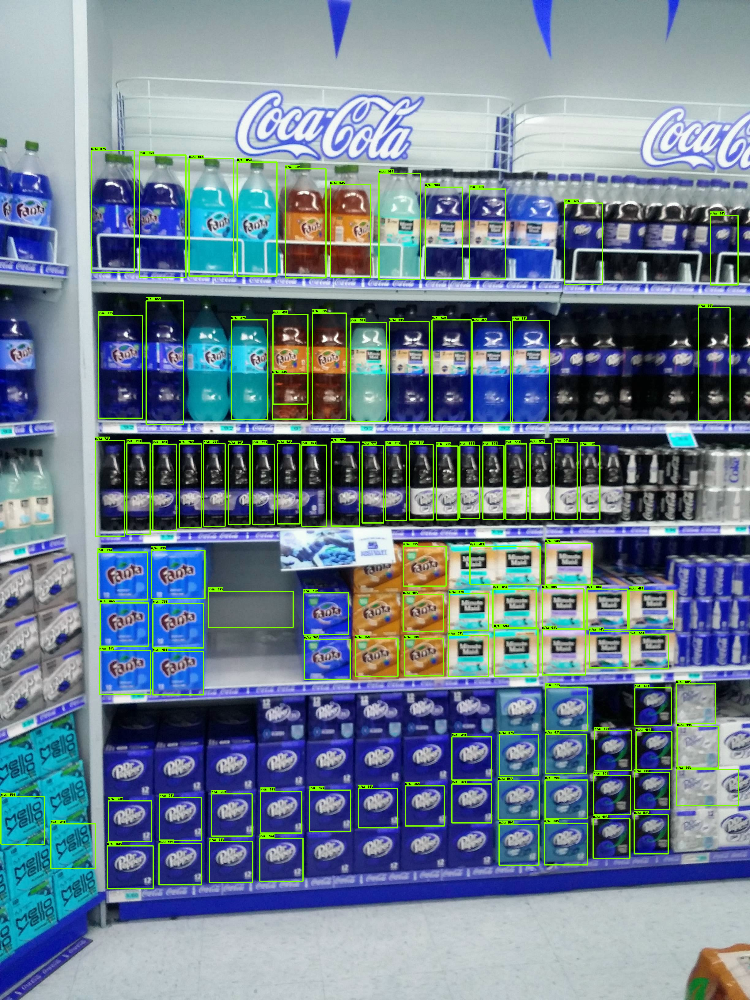

ResNet_v2


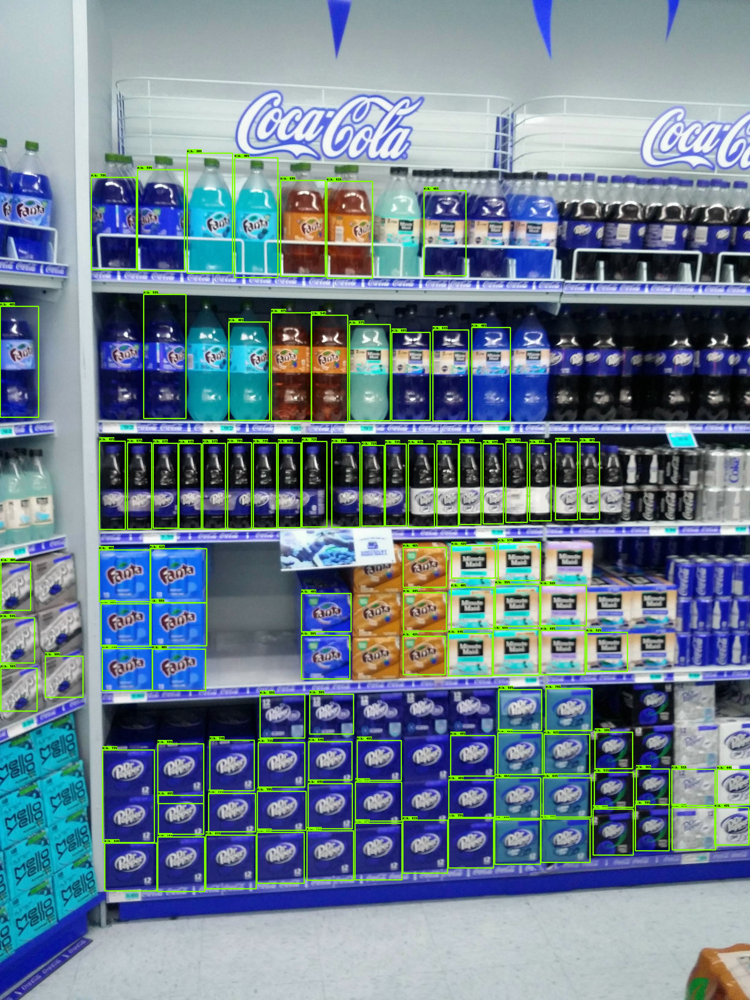

MobileNet_v2_FPNLite


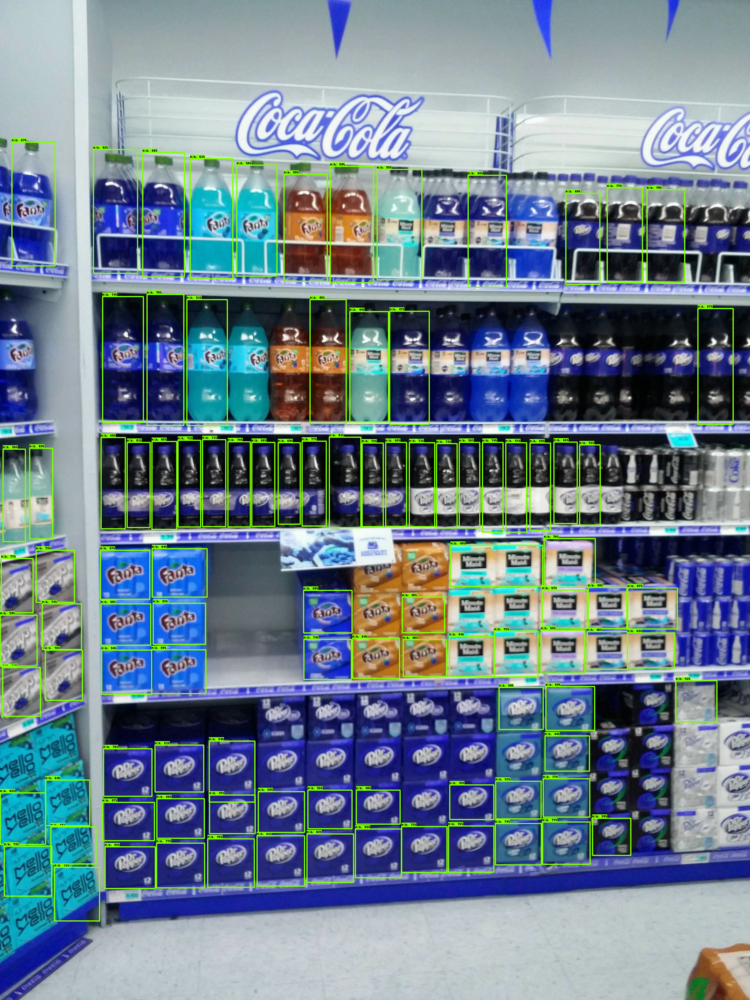

In [79]:
def load_image_into_numpy_array(path):
    """Load an image from file into a numpy array.
    Puts image into numpy array to feed into tensorflow graph.
    Note that by convention we put it into a numpy array with shape
    (height, width, channels), where channels=3 for RGB.
    Args:
      path: the file path to the image
    Returns:
      uint8 numpy array with shape (img_height, img_width, 3)
    """
    return np.array(Image.open(path))




print('Running inference for {}... '.format(IMAGE_PATHS), end='')

image = cv2.imread(IMAGE_PATHS)
image_rgb = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
image_expanded = np.expand_dims(image_rgb, axis=0)

# The input needs to be a tensor, convert it using `tf.convert_to_tensor`.
input_tensor = tf.convert_to_tensor(image)
# The model expects a batch of images, so add an axis with `tf.newaxis`.
input_tensor = input_tensor[tf.newaxis, ...]

# detection for mobileNetv1fpn
mobilenet_v1_detections = mobilenet_v1_detect_fn(input_tensor)

# All outputs are batches tensors.
# Convert to numpy arrays, and take index [0] to remove the batch dimension.
# We're only interested in the first num_detections.
num_detections = int(mobilenet_v1_detections.pop('num_detections'))
mobilenet_v1_detections = {key: value[0, :num_detections].numpy()
               for key, value in mobilenet_v1_detections.items()}
mobilenet_v1_detections['num_detections'] = num_detections

# detection_classes should be ints.
mobilenet_v1_detections['detection_classes'] = mobilenet_v1_detections['detection_classes'].astype(np.int64)

mobilenet_v1_image_with_detections = image.copy()
vis_util.visualize_boxes_and_labels_on_image_array(
            mobilenet_v1_image_with_detections,
            mobilenet_v1_detections['detection_boxes'],
            mobilenet_v1_detections['detection_classes'],
            mobilenet_v1_detections['detection_scores'],
            {'object':1},
            use_normalized_coordinates=True,
            max_boxes_to_draw=200,
            min_score_thresh=.1,
            agnostic_mode=False)

#detection via resnet_v2 
resnet_v2_detections = resnet_v2_detect_fn(input_tensor)

# All outputs are batches tensors.
# Convert to numpy arrays, and take index [0] to remove the batch dimension.
# We're only interested in the first num_detections.
num_detections = int(resnet_v2_detections.pop('num_detections'))
resnet_v2_detections = {key: value[0, :num_detections].numpy()
               for key, value in resnet_v2_detections.items()}
resnet_v2_detections['num_detections'] = num_detections

# detection_classes should be ints.
resnet_v2_detections['detection_classes'] = resnet_v2_detections['detection_classes'].astype(np.int64)

resnet_v2_image_with_detections = image.copy()
vis_util.visualize_boxes_and_labels_on_image_array(
            resnet_v2_image_with_detections,
            resnet_v2_detections['detection_boxes'],
            resnet_v2_detections['detection_classes'],
            resnet_v2_detections['detection_scores'],
            {'object':1},
            use_normalized_coordinates=True,
            max_boxes_to_draw=200,
            min_score_thresh=.1,
            agnostic_mode=False)

#detection via fpnlite
mobilenet_v2_fpnlite_detections = mobilenet_v2_fpnlite_detect_fn(input_tensor)

# All outputs are batches tensors.
# Convert to numpy arrays, and take index [0] to remove the batch dimension.
# We're only interested in the first num_detections.
num_detections = int(mobilenet_v2_fpnlite_detections.pop('num_detections'))
mobilenet_v2_fpnlite_detections = {key: value[0, :num_detections].numpy()
               for key, value in mobilenet_v2_fpnlite_detections.items()}
mobilenet_v2_fpnlite_detections['num_detections'] = num_detections

# detection_classes should be ints.
mobilenet_v2_fpnlite_detections['detection_classes'] = mobilenet_v2_fpnlite_detections['detection_classes'].astype(np.int64)

mobilenet_v2_fpnlite_image_with_detections = image.copy()
vis_util.visualize_boxes_and_labels_on_image_array(
            mobilenet_v2_fpnlite_image_with_detections,
            mobilenet_v2_fpnlite_detections['detection_boxes'],
            mobilenet_v2_fpnlite_detections['detection_classes'],
            mobilenet_v2_fpnlite_detections['detection_scores'],
            {'object':1},
            use_normalized_coordinates=True,
            max_boxes_to_draw=200,
            min_score_thresh=.1,
            agnostic_mode=False)

print("MobileNet_v1")
cv2_imshow(cv2.cvtColor(mobilenet_v1_image_with_detections, cv2.COLOR_BGR2RGB))
print("ResNet_v2")
cv2_imshow(cv2.cvtColor(resnet_v2_image_with_detections, cv2.COLOR_BGR2RGB))
print("MobileNet_v2_FPNLite")
cv2_imshow(cv2.cvtColor(mobilenet_v2_fpnlite_image_with_detections, cv2.COLOR_BGR2RGB))

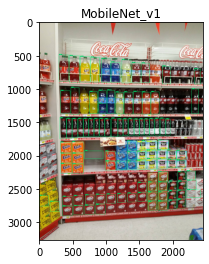

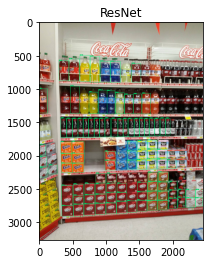

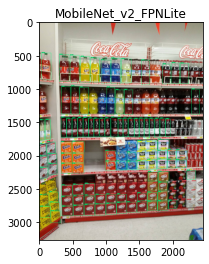

In [80]:
plt.title("MobileNet_v1")
plt.imshow(cv2.cvtColor(mobilenet_v1_image_with_detections, cv2.COLOR_BGR2RGB))
plt.show()
plt.title("ResNet")
plt.imshow(cv2.cvtColor(resnet_v2_image_with_detections, cv2.COLOR_BGR2RGB))
plt.show()
plt.title("MobileNet_v2_FPNLite")
plt.imshow(cv2.cvtColor(mobilenet_v2_fpnlite_image_with_detections, cv2.COLOR_BGR2RGB))
plt.show()

### Quantitative Analysis


In [67]:
def get_scores_detections(image,detections,detection_threshold):
  scores = list(filter(lambda x: x> detection_threshold, detections['detection_scores']))
  boxes = detections['detection_boxes'][:len(scores)]
  return np.array(scores).mean(),len(boxes)

In [74]:
#MobileNet_v1
MobileNet_V1_AP, MobileNet_V1_detections = get_scores_detections(mobilenet_v1_image_with_detections,mobilenet_v1_detections,0.5)
print(MobileNet_V1_AP,MobileNet_V1_detections)
#ResNet_v2
ResNet_V2_AP, ResNet_V2_detections = get_scores_detections(resnet_v2_image_with_detections,resnet_v2_detections,0.5)
print(ResNet_V2_AP,ResNet_V2_detections)
#MobileNet_v2_FPNLite
MobileNet_V2_FPNLite_AP, MobileNet_V2_FPNLite_detections = get_scores_detections(mobilenet_v2_fpnlite_image_with_detections,mobilenet_v2_fpnlite_detections,0.5)
print(MobileNet_V2_FPNLite_AP, MobileNet_V2_FPNLite_detections)

0.6707969 68
0.6731784 76
0.70474595 88


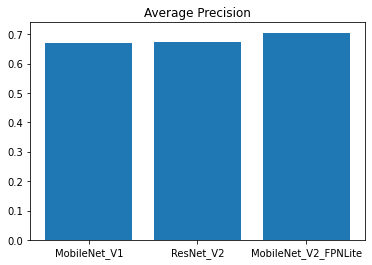

In [75]:
import matplotlib.pyplot as plt
%matplotlib inline

data = {"MobileNet_V1":MobileNet_V1_AP,"ResNet_V2":ResNet_V2_AP,"MobileNet_V2_FPNLite":MobileNet_V2_FPNLite_AP}
names = list(data.keys())
values = list(data.values())

plt.bar(range(len(data)), values, tick_label=names)
plt.title("Average Precision")
plt.show()

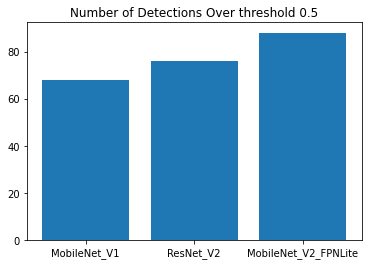

In [76]:
import matplotlib.pyplot as plt
%matplotlib inline

data = {"MobileNet_V1":MobileNet_V1_detections,"ResNet_V2":ResNet_V2_detections,"MobileNet_V2_FPNLite":MobileNet_V2_FPNLite_detections}
names = list(data.keys())
values = list(data.values())

plt.bar(range(len(data)), values, tick_label=names)
plt.title("Number of Detections Over threshold 0.5")
plt.show()